Hi,

In this project I perform an EDA (exploratory data analysis) with the use of the Pycaret package. In short, Pycaret is a wrapper around the most used python packages for Data Science. Such as sklearn, numpy, pandas etc.
More info on https://pycaret.org/ 

Final result of this project: **86% Accuracy on the test set**

Workflow layout:

- Import Data, Split data and drop Nan's in the target data

- First glimp at the data

- EDA with Pandas Profiling

- Setup the Pycaret Environment

- Compare models

- Light GBM

- Compare with Logistic Regression

- Blend/Stack the models

- Finalizing the LightGBM



# *Install pycaret (google colab does not have Pycaret installed)*

In [ ]:
!pip install -U pandas-profiling[notebook] --quiet # update the pandas profilling library
!pip install pycaret[full] --quiet
!pip install scikit-optimize --quiet # install scikit-optimize for the hyperparameter optimization

Restart kernel (google colab)

# import data

In [ ]:
# import pandas to get the data
import pandas as pd

from pycaret.utils import enable_colab # just for google colab
enable_colab()

Colab mode enabled.


In [ ]:
# import data
df = pd.read_csv('/content/weatherAUS.csv', parse_dates=['Date'], index_col='Date') # set Date column to 'datetime' type and as the index column

# First glimp at the data

In [ ]:
# check first rows
df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
Date,,,,,,,,,,,,,,,,,,,,,,
2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [ ]:
# check last rows
df.tail()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
Date,,,,,,,,,,,,,,,,,,,,,,
2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,ENE,13.0,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,N,13.0,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,WNW,9.0,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,N,13.0,7.0,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,ESE,17.0,17.0,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 145460 entries, 2008-12-01 to 2017-06-25
Data columns (total 22 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Location       145460 non-null  object 
 1   MinTemp        143975 non-null  float64
 2   MaxTemp        144199 non-null  float64
 3   Rainfall       142199 non-null  float64
 4   Evaporation    82670 non-null   float64
 5   Sunshine       75625 non-null   float64
 6   WindGustDir    135134 non-null  object 
 7   WindGustSpeed  135197 non-null  float64
 8   WindDir9am     134894 non-null  object 
 9   WindDir3pm     141232 non-null  object 
 10  WindSpeed9am   143693 non-null  float64
 11  WindSpeed3pm   142398 non-null  float64
 12  Humidity9am    142806 non-null  float64
 13  Humidity3pm    140953 non-null  float64
 14  Pressure9am    130395 non-null  float64
 15  Pressure3pm    130432 non-null  float64
 16  Cloud9am       89572 non-null   float64
 17  Cloud3pm     

In [ ]:
#sort the df by index (Date column)
df.sort_index(inplace=True)
print(df.head())
print(df.tail())

            Location  MinTemp  MaxTemp  ...  Temp3pm  RainToday  RainTomorrow
Date                                    ...                                  
2007-11-01  Canberra      8.0     24.3  ...     23.6         No           Yes
2007-11-02  Canberra     14.0     26.9  ...     25.7        Yes           Yes
2007-11-03  Canberra     13.7     23.4  ...     20.2        Yes           Yes
2007-11-04  Canberra     13.3     15.5  ...     14.1        Yes           Yes
2007-11-05  Canberra      7.6     16.1  ...     15.4        Yes            No

[5 rows x 22 columns]
                    Location  MinTemp  MaxTemp  ...  Temp3pm  RainToday  RainTomorrow
Date                                            ...                                  
2017-06-25              Sale      0.1     14.8  ...     14.0         No            No
2017-06-25  MelbourneAirport      5.5     13.9  ...     12.2         No            No
2017-06-25         Melbourne      8.6     14.3  ...     13.4         No           Yes
2

In [ ]:
df.shape

(145460, 22)

Quick observations:
- A lot of missing values!
- Most numeric values

We will analyse this further with the train set in the pandas profiling library

In [ ]:
# check NaN's in the target Data
df['RainTomorrow'].isnull().sum()

3267

The data contains Nan's values in the target data. These are in a fully supervised classification useless, so lets drop them.

In [ ]:
from sklearn.model_selection import train_test_split

#Drop Nan's in the target data
df.dropna(axis=0, subset=['RainTomorrow'], inplace=True) # drop the rows with no target values (useless in fully supervised training)

#split the data into train and test
df_train, df_test = train_test_split(df, test_size=0.2, random_state=123, stratify=df['RainTomorrow'])

# EDA (with Pandas Profiling)

In [ ]:
from pandas_profiling import ProfileReport

profile = ProfileReport(df_train, title="Rain Australia", minimal=True) # just a first look

In [ ]:
profile

Summarize dataset:   0%|          | 0/31 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

The first thing I notice is that some columns have a very high proportion of missing data (< 35% in one column). So the first question that arises is; "Do these columns/features matter in predicting the rain tomorrow?" If they do, dropping them would result in a massive data loss. But on the other side, a data imputation would be ineffective because these data do definitely not have data missing at random (MAR). The columns that have a a lot of missing data are;


    - Evaporation
    - Sunshine
    - Cloud9am
    - Cloud3pm

Theoretically, these features are important since you can imagine that clouds may be hang over the sky for a while. And a sunny day may be prolonged in with another sunny day. This is especially the case in a for example a land climate. The climate around a sea may be more volatile. Lastly, evaporation should (obviously) also be linked to rainfall.

A second thing to mention is that the target column is not equally distributed. The ratio is about 1:3. However, we have a very large data set and models are quiet good at handeling imbalances if the imbalance is not that skewed.

Lastly, rows with more than 50% NaN's should be dropped, since these could not be very valueable in our analysis. We can afford this massive amount of dropping rows because we still end up with a large amount of data. But to be sure that we do not bias the data, we should do a EDA on the data with dropped rows.
Let's find out with an EDA on the data with ~40 % dropped rows, dropped NaN's in the target column and drop useless rows. 

Note: We drop the 40% rows by using just a few columns. The reason for just a few columns is that most Nan's are probably systemetic.

In [ ]:
# drop "some" rows
df_train_edit = (df_train.copy()
                        .dropna(subset=['Cloud9am', 'Evaporation']) # drop the rows with NaN's in columns that have a lot of NaN's
                        .dropna(axis=0, how='any', thresh=12)) # drop rows that have more than 50% NaN's in a row (~12 NaN's)   # drop the rows of some features
drop_profile = ProfileReport(df_train_edit, title="Rain Australia with dropped rows")

In [ ]:
drop_profile

Summarize dataset:   0%|          | 0/36 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
# Download the final EDA
drop_profile.to_file('EDA_Rain.html')

from google.colab import files
files.download('EDA_Rain.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Since we started with a lot of data, the histogram distributions of the features do not change that much, although we lost some locations and went from 43 locations to 26 locations. Since our goal is to make a general predictor for the rain the next day, this is not a huge problem. A problem might be an unbalanced (not uniform) distribution of the locations, what could cause a biased view of the weather in Australia. Let's see the histogram of the location column.

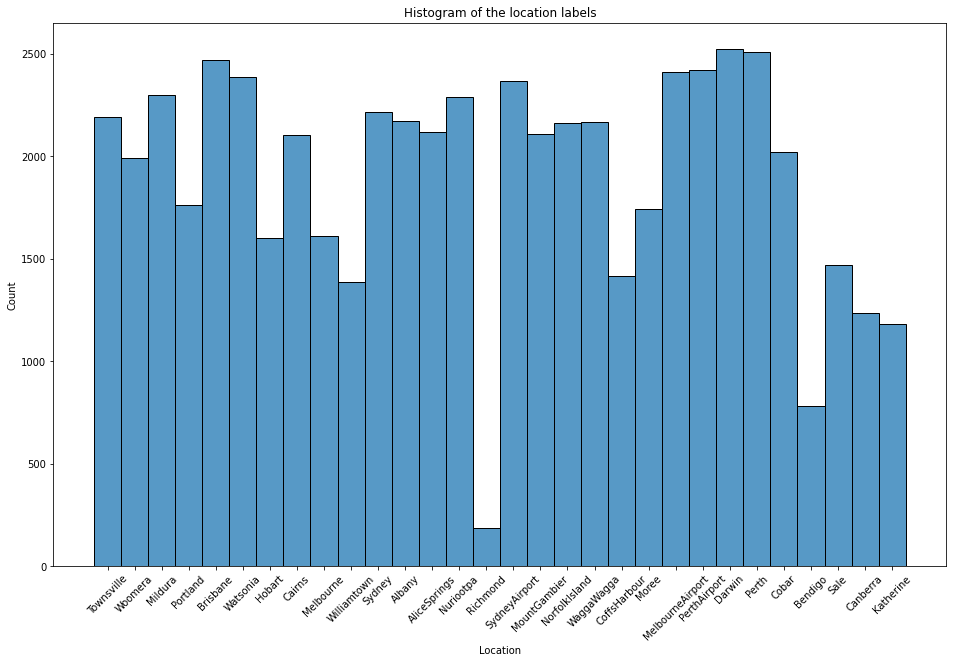

In [ ]:
# plot the histogram on samples per city
import matplotlib.pyplot as plt
import seaborn as sns 
plt.figure(figsize=(16,10))
sns.histplot(data=df_train_edit['Location'])
plt.title('Histogram of the location labels')
plt.xticks(rotation=45)
plt.show()

Observations after dropping the data:

There are lot's of correlated features.

Most highly correlated features:
  - Cloud3pm with Cloud9am
  - Temp3pm with MaxTemp
  - Sunnshine with the pressure features
  - Maxtemp and MinTemp
  - Temp9am and Temp3pm

Correlated features could mean a distortion in the prediction of a model. We fix this in pycaret with the remove_multicollinearity option during the "setup". We set the threshold at .85 which means that with a correlation higher than .85 one of the correlated features will be removed. The one feature that is removed is most less correlated with the target variable.

--------------------------------------------------------------------------------

Second, there is still 1.6% of missing data in total. The missing data will be filled with an imputation using the mean (with numeric values and an 'not aviablable' value for categorical features


--------------------------------------------------------------------------

Lastly, we have some right skewed distributed features. This might cause problems with some models. To avoid this, we use the transformation option in the "setup" (in pycaret). 

# Setup up the Pycaret environment

In [ ]:
from pycaret.classification import *

Setup the Pycaret environment with the "setup"

In [ ]:
# Pycaret is not fully correct on the data types so a list of categorical features is required
cardinal_features = ['Location'] # to avoid a high amount of dimensions we encode the location feature with the frequency of occurences.

numeric_features = ['Cloud3pm'] # tis feature is mininterpreted as a categorical feature

rainf_clf = setup(data = df_train_edit, # using the dropped data
                  target='RainTomorrow',
                  session_id=123, # to keep consistency
                  # custom_pipeline=('feature_eng', column_trans), # the MaxTemp column is not recognized >>> exluded because of multicolinearity!
                  numeric_features=numeric_features,
                  high_cardinality_features=cardinal_features,
                  normalize=True, # with the z-score
                  ignore_low_variance=True,
                  numeric_imputation='median',
                  transformation=True, # to combat the right skewed distributions
                  remove_multicollinearity=True, multicollinearity_threshold= 0.85, #features with an inter-corelation above .85
                  bin_numeric_features=['Rainfall', 'Sunshine'],
                  log_experiment=True, experiment_name='Rainfall_prediction',
                  fix_imbalance=False, # since we have a lot of samples and the imbalance is not that big, this could be fixed by adjusting the weights of the models
                  fold=3 # since we have a large dataset 3 folds is enough
                  )

,Description,Value
0,session_id,123
1,Target,RainTomorrow
2,Target Type,Binary
3,Label Encoded,"No: 0, Yes: 1"
4,Original Data,"(57293, 22)"
5,Missing Values,True
6,Numeric Features,16
7,Categorical Features,5
8,Ordinal Features,False
9,High Cardinality Features,True


In [ ]:
models() # available models (since we have a large dataset only those with "Turbo" are used)

,Name,Reference,Turbo
ID,,,
lr,Logistic Regression,sklearn.linear_model._logistic.LogisticRegression,True
knn,K Neighbors Classifier,sklearn.neighbors._classification.KNeighborsCl...,True
nb,Naive Bayes,sklearn.naive_bayes.GaussianNB,True
dt,Decision Tree Classifier,sklearn.tree._classes.DecisionTreeClassifier,True
svm,SVM - Linear Kernel,sklearn.linear_model._stochastic_gradient.SGDC...,True
rbfsvm,SVM - Radial Kernel,sklearn.svm._classes.SVC,False
gpc,Gaussian Process Classifier,sklearn.gaussian_process._gpc.GaussianProcessC...,False
mlp,MLP Classifier,sklearn.neural_network._multilayer_perceptron....,False
ridge,Ridge Classifier,sklearn.linear_model._ridge.RidgeClassifier,True


# Compare the models

In [ ]:
best_model = compare_models(sort='AUC') # let's compare the models on their AUC score

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
catboost,CatBoost Classifier,0.8608,0.8922,0.5469,0.7466,0.6313,0.5480,0.5581,18.7733
lightgbm,Light Gradient Boosting Machine,0.8583,0.8878,0.5465,0.7352,0.6270,0.5418,0.5509,0.8567
xgboost,Extreme Gradient Boosting,0.8565,0.8857,0.5512,0.7240,0.6259,0.5391,0.5468,12.8733
rf,Random Forest Classifier,0.8562,0.8836,0.4896,0.7659,0.5973,0.5149,0.5340,4.8033
lr,Logistic Regression,0.8538,0.8819,0.5336,0.7228,0.6139,0.5263,0.5355,2.7867
gbc,Gradient Boosting Classifier,0.8544,0.8800,0.5153,0.7373,0.6066,0.5206,0.5333,6.8067
lda,Linear Discriminant Analysis,0.8504,0.8776,0.5430,0.7030,0.6127,0.5219,0.5286,0.7533
et,Extra Trees Classifier,0.8506,0.8769,0.4682,0.7524,0.5772,0.4924,0.5129,5.7633
ada,Ada Boost Classifier,0.8481,0.8729,0.5066,0.7134,0.5924,0.5023,0.5135,1.9200
knn,K Neighbors Classifier,0.8415,0.8298,0.4967,0.6891,0.5773,0.4829,0.4927,118.3067


# Light GBM

Although the Catboost Classifier has a slightly higher AUC, the TT (training time) of the LightGBM Classifier is significantly smaller. This is far more benefical than the very slight AUC improvement. Furthermore, both are tree-based models, so there is quiet some overlap in the used techniques.

In [ ]:
lightgbm = create_model('lightgbm', fold=4)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8596,0.8886,0.5487,0.7397,0.6301,0.5457,0.5550
1,0.8607,0.8892,0.5568,0.7392,0.6352,0.5511,0.5596
2,0.8568,0.8856,0.5462,0.7283,0.6243,0.5380,0.5465
3,0.8628,0.8930,0.5522,0.7519,0.6367,0.5546,0.5646
Mean,0.8599,0.8891,0.5510,0.7398,0.6316,0.5474,0.5564
SD,0.0022,0.0026,0.0040,0.0083,0.0049,0.0062,0.0067


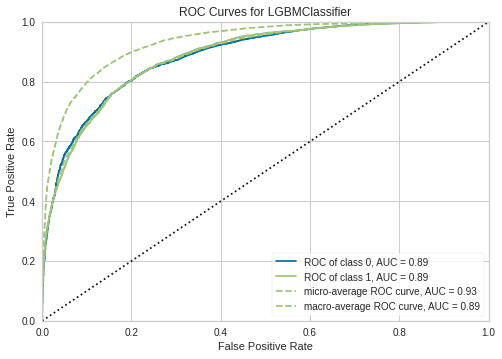

In [ ]:
plot_model(lightgbm) # AUC curve

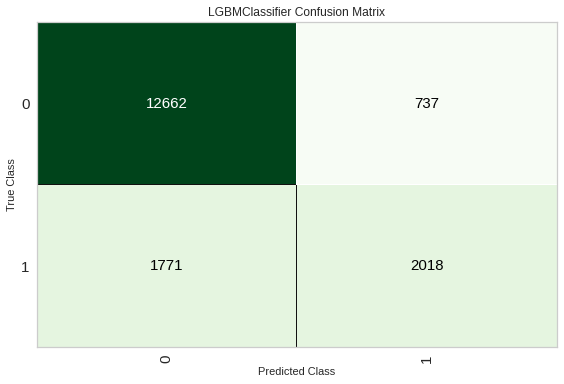

In [ ]:
plot_model(lightgbm, plot='confusion_matrix')

In [ ]:
tuned_gbm = tune_model(lightgbm, optimize='AUC', n_iter=10, early_stopping=True, early_stopping_max_iters=3, fold=4, search_library='scikit-optimize') # hyper parameter optimization with scikit-optimize

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8593,0.8884,0.5117,0.7647,0.6131,0.5312,0.5472
1,0.8590,0.8907,0.5151,0.7601,0.6141,0.5317,0.5467
2,0.8592,0.8868,0.5096,0.7655,0.6119,0.5300,0.5464
3,0.8601,0.8921,0.5087,0.7710,0.6130,0.5319,0.5490
Mean,0.8594,0.8895,0.5113,0.7653,0.6130,0.5312,0.5474
SD,0.0004,0.0020,0.0025,0.0039,0.0008,0.0007,0.0010


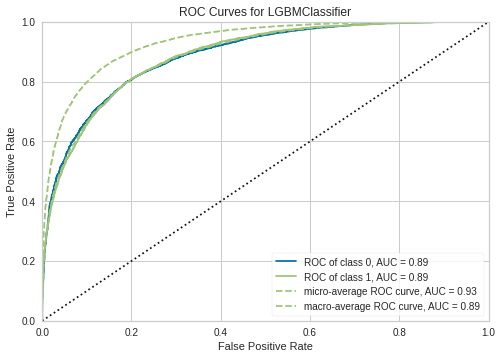

In [ ]:
plot_model(tuned_gbm)

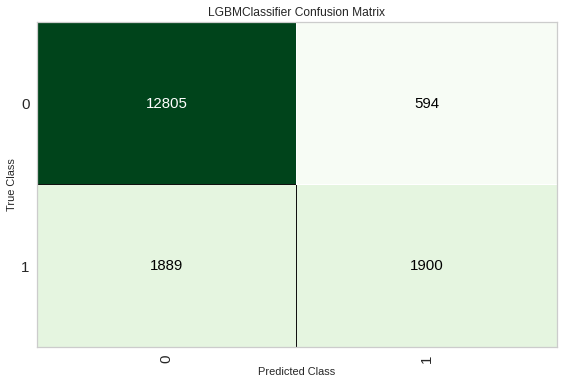

In [ ]:
plot_model(tuned_gbm, plot='confusion_matrix')

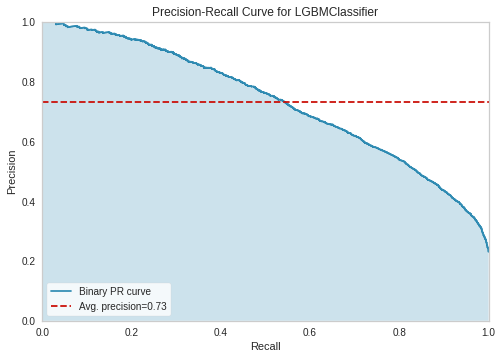

In [ ]:
plot_model(tuned_gbm, plot='pr')

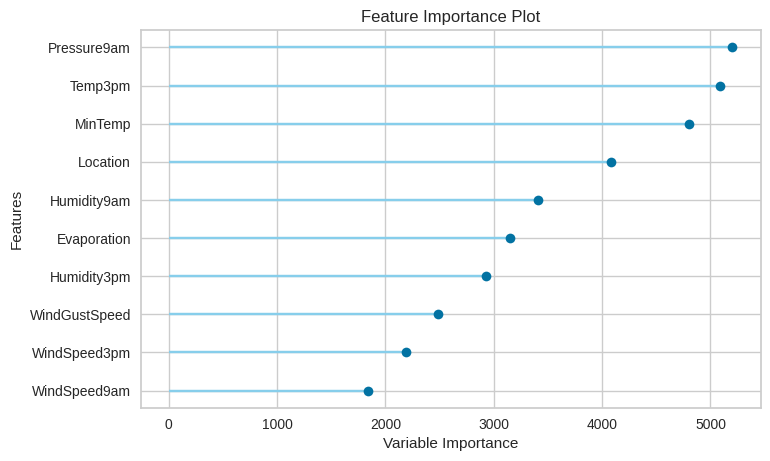

In [ ]:
plot_model(tuned_gbm, plot='feature')

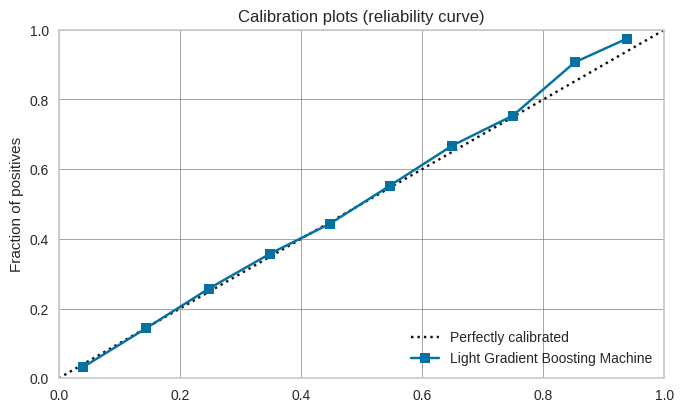

In [ ]:
plot_model(tuned_gbm, plot='calibration')

In [ ]:
calibrated_gbm = calibrate_model(tuned_gbm, fold=4)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8585,0.8881,0.5355,0.7433,0.6225,0.5382,0.5492
1,0.8590,0.8901,0.5426,0.7406,0.6263,0.5419,0.5519
2,0.8583,0.8858,0.5325,0.7441,0.6208,0.5365,0.5479
3,0.8606,0.8912,0.5302,0.7569,0.6236,0.5413,0.5542
Mean,0.8591,0.8888,0.5352,0.7462,0.6233,0.5395,0.5508
SD,0.0009,0.0020,0.0047,0.0063,0.0020,0.0022,0.0024


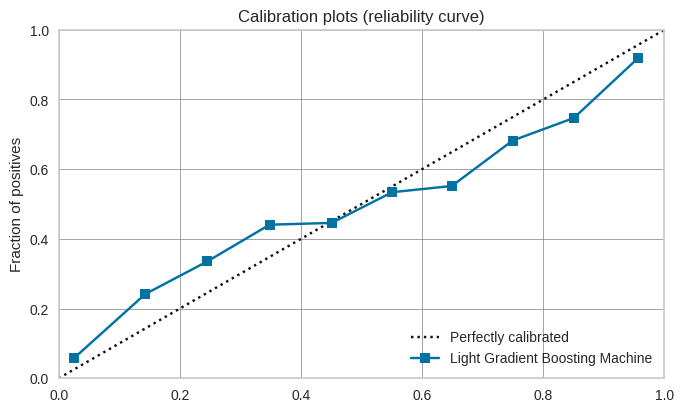

In [ ]:
plot_model(calibrated_gbm, plot='calibration')

No improvements after the calibration

# Compare with Logistic Regression

We compare the Light GBM Classifier with Logistic regression, since this estimator also had promising results in the comparison and not a tree based algorithm what may be promising with blending/stacking the two models (Light GBM and Logistic regression)

In [ ]:
lr = create_model('lr', fold=4)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8534,0.8811,0.5304,0.7230,0.6119,0.5242,0.5337
1,0.8534,0.8818,0.5375,0.7185,0.6150,0.5267,0.5352
2,0.8514,0.8795,0.5307,0.7137,0.6087,0.5194,0.5281
3,0.8564,0.8851,0.5362,0.7328,0.6192,0.5333,0.5432
Mean,0.8536,0.8819,0.5337,0.7220,0.6137,0.5259,0.5351
SD,0.0018,0.0020,0.0032,0.0071,0.0039,0.0050,0.0054


In [ ]:
tuned_lr = tune_model(lr,optimize='AUC', fold=4, n_iter=10, early_stopping=True, early_stopping_max_iters=3, search_library='scikit-optimize')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8011,0.8810,0.7941,0.5291,0.6351,0.5058,0.5255
1,0.7929,0.8818,0.8059,0.5158,0.6290,0.4948,0.5185
2,0.7902,0.8798,0.7940,0.5120,0.6225,0.4865,0.5089
3,0.8039,0.8854,0.8031,0.5331,0.6408,0.5134,0.5338
Mean,0.7971,0.8820,0.7992,0.5225,0.6319,0.5001,0.5217
SD,0.0056,0.0021,0.0053,0.0088,0.0068,0.0103,0.0091


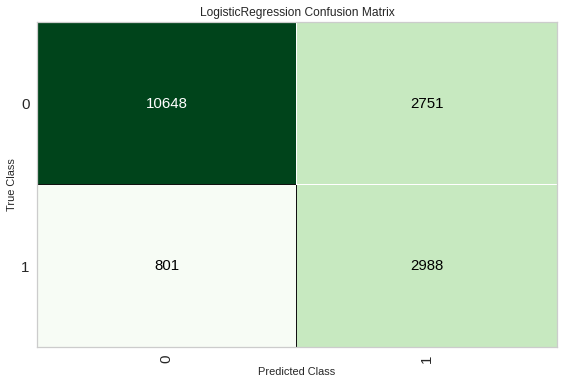

In [ ]:
plot_model(tuned_lr, plot='confusion_matrix')

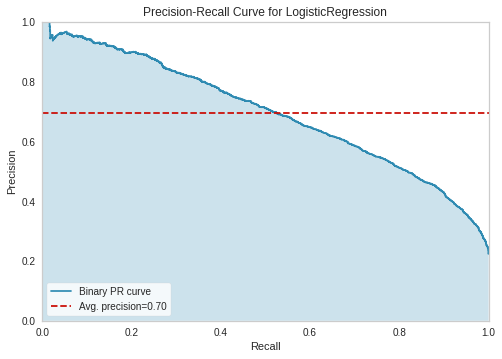

In [ ]:
plot_model(tuned_lr, plot='pr')

The Logistic regression Classifier shows a high recall, but low precision. this makes the estimator less likly to pick as a final model. But perhaps a blend/stacking of the Light GBM and de Logistic Regression might suprise us.

# Blend Models (LIght GBM and LR)

In [ ]:
blend_model = blend_models(estimator_list=[tuned_gbm, tuned_lr], fold=4)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8483,0.8876,0.6709,0.6464,0.6584,0.5610,0.5611
1,0.8406,0.8887,0.6648,0.6264,0.6450,0.5424,0.5428
2,0.8422,0.8862,0.6676,0.6301,0.6483,0.5467,0.5471
3,0.8512,0.8915,0.6795,0.6520,0.6655,0.5698,0.5700
Mean,0.8456,0.8885,0.6707,0.6387,0.6543,0.5550,0.5553
SD,0.0043,0.0020,0.0055,0.0107,0.0081,0.0110,0.0109


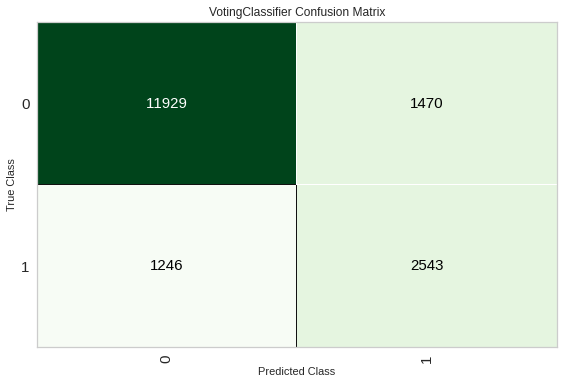

In [ ]:
plot_model(blend_model, plot='confusion_matrix')

# Stack model (Light GBM and LR)

In [ ]:
stack_model = stack_models(estimator_list=[tuned_gbm, tuned_lr])

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.8569,0.8876,0.5311,0.7388,0.6179,0.5328,0.5438
1,0.8585,0.8872,0.5405,0.7397,0.6246,0.5400,0.5501
2,0.8600,0.8916,0.5254,0.7578,0.6206,0.5382,0.5518
Mean,0.8585,0.8888,0.5323,0.7454,0.6210,0.5370,0.5485
SD,0.0013,0.0020,0.0062,0.0088,0.0027,0.0031,0.0034


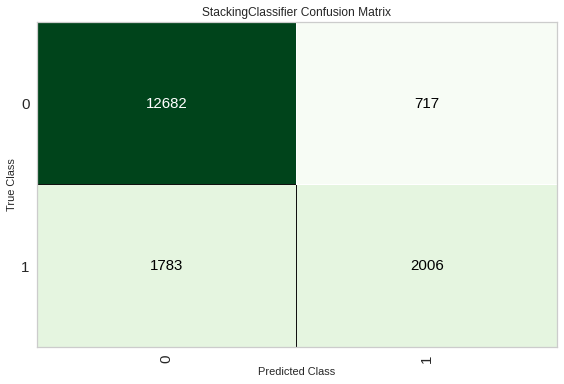

In [ ]:
plot_model(stack_model, plot='confusion_matrix')

Stacking or blending the two estimators does not have the desired effect. So let's stick with the Light GBM Classifier.

# Finalizing the Light GBM model

In [ ]:
predict_model(tuned_gbm)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.8555,0.8881,0.5015,0.7618,0.6048,0.521,0.538


,Location,MinTemp,Evaporation,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Cloud9am,Cloud3pm,Temp3pm,WindGustDir_E,WindGustDir_ENE,WindGustDir_ESE,WindGustDir_N,WindGustDir_NE,WindGustDir_NNE,WindGustDir_NNW,WindGustDir_NW,WindGustDir_S,WindGustDir_SE,WindGustDir_SSE,WindGustDir_SSW,WindGustDir_SW,WindGustDir_W,WindGustDir_WNW,WindGustDir_WSW,WindGustDir_not_available,WindDir9am_E,WindDir9am_ENE,WindDir9am_ESE,WindDir9am_N,WindDir9am_NE,WindDir9am_NNE,WindDir9am_NNW,WindDir9am_NW,WindDir9am_S,WindDir9am_SE,WindDir9am_SSE,...,WindDir3pm_not_available,RainToday_Yes,RainToday_not_available,Rainfall_0.0,Rainfall_1.0,Rainfall_10.0,Rainfall_11.0,Rainfall_12.0,Rainfall_13.0,Rainfall_14.0,Rainfall_15.0,Rainfall_16.0,Rainfall_2.0,Rainfall_3.0,Rainfall_4.0,Rainfall_5.0,Rainfall_6.0,Rainfall_7.0,Rainfall_8.0,Rainfall_9.0,Sunshine_0.0,Sunshine_1.0,Sunshine_10.0,Sunshine_11.0,Sunshine_12.0,Sunshine_13.0,Sunshine_14.0,Sunshine_15.0,Sunshine_16.0,Sunshine_2.0,Sunshine_3.0,Sunshine_4.0,Sunshine_5.0,Sunshine_6.0,Sunshine_7.0,Sunshine_8.0,Sunshine_9.0,RainTomorrow,Label,Score
0,0.619052,-1.652253,-1.843077,-1.052361,-0.686175,-0.448250,0.910306,0.258442,1.148077,0.222442,-1.243067,-1.679941,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,No,No,0.9600
1,1.774067,0.565122,0.811769,0.452864,0.141627,0.633595,-0.378563,-0.036650,-0.316977,0.222442,-1.243067,0.456327,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,No,No,0.9644
2,0.020098,0.335709,0.215471,2.018946,1.417877,1.223277,-0.327553,0.406271,-0.979822,-0.799443,-1.243067,-0.420561,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,No,No,0.7243
3,1.187350,-0.081394,-1.419344,-0.511230,-1.499307,-1.328332,-0.766765,-1.015075,-0.936651,-1.112518,1.032199,0.861990,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,No,No,0.8813
4,0.619052,-1.636158,-0.623457,0.378733,-0.999381,0.191201,1.042698,0.554262,0.697117,0.990192,0.151799,-1.059423,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Yes,No,0.6857
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17183,-1.005657,-0.472876,-1.843077,1.215023,0.887600,1.495300,1.313644,0.061622,-0.389139,0.990192,0.151799,-0.661639,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,No,No,0.6545
17184,-1.005657,0.549871,0.589712,-0.511230,1.072605,-0.729541,-0.719940,-0.819894,0.087800,-0.136000,0.577598,1.237208,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0

In [ ]:
final_gbm = finalize_model(tuned_gbm)

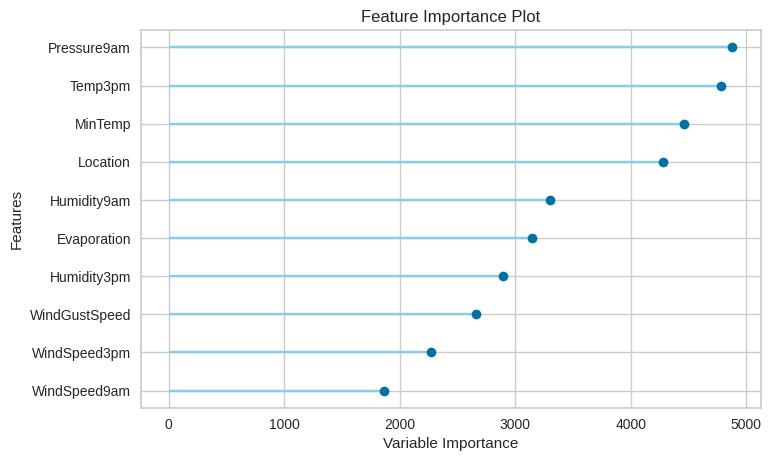

In [ ]:
plot_model(final_gbm, plot='feature')

In [ ]:
save_model(final_gbm, 'gbm_model_15May2021')
files.download('gbm_model_15May2021.pkl')
print(final_gbm)

Transformation Pipeline and Model Succesfully Saved


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

LGBMClassifier(bagging_fraction=0.8608120752388259, bagging_freq=1,
               boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               feature_fraction=0.4284489606984907, importance_type='split',
               learning_rate=0.016133245419918712, max_depth=-1,
               min_child_samples=95, min_child_weight=0.001,
               min_split_gain=0.8209314243567916, n_estimators=239, n_jobs=-1,
               num_leaves=183, objective=None, random_state=123,
               reg_alpha=8.662569304197528e-07,
               reg_lambda=5.001062744294253e-06, silent=True, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)


In [ ]:
predictions = predict_model(final_gbm)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.8775,0.9262,0.5587,0.8302,0.6679,0.5963,0.6139


In [ ]:
unseen_predictions = predict_model(final_gbm, data=df_test.dropna())
unseen_predictions.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Label,Score
Date,,,,,,,,,,,,,,,,,,,,,,,,
2010-07-31,PerthAirport,7.0,19.5,0.0,1.2,7.9,ENE,26.0,NE,S,11.0,11.0,90.0,55.0,1030.6,1029.7,1.0,7.0,11.4,18.5,No,No,No,0.9394
2014-07-04,Hobart,7.1,14.8,0.0,2.8,4.0,NNW,22.0,NW,W,6.0,9.0,72.0,64.0,1010.0,1006.7,1.0,5.0,7.8,13.8,No,No,No,0.7849
2012-10-12,Woomera,5.6,20.9,0.4,7.4,10.0,SSE,37.0,S,SSW,20.0,20.0,63.0,23.0,1027.4,1025.0,0.0,0.0,10.5,18.7,No,No,No,0.9861
2011-06-05,Townsville,15.0,26.7,0.0,4.8,4.9,ENE,30.0,SSE,NE,11.0,20.0,69.0,64.0,1017.9,1014.5,7.0,7.0,21.5,24.2,No,No,No,0.8854
2011-05-09,Darwin,22.5,31.6,0.0,3.6,7.5,N,31.0,ENE,NNE,7.0,22.0,77.0,56.0,1013.0,1010.3,7.0,6.0,26.6,30.8,No,No,No,0.8113


Accuracy score on the test set

In [ ]:
from pycaret.utils import check_metric
check_metric(unseen_predictions['RainTomorrow'], unseen_predictions['Label'], metric = 'Accuracy')

0.8584